In [2]:
import torch
from sklearn.model_selection import train_test_split

# load data from data folder(we"re in notebooks folder)
sim_arr_tensor = torch.load('./data/sim_arr_tensor.pt')

# train test split
train_data, test_data = train_test_split(
    sim_arr_tensor, test_size=0.2, random_state=42)
train_data, val_data = train_test_split(
    train_data, test_size=0.2, random_state=42)

/tmp/ipykernel_1556636/1126774367.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sim_arr_tensor = torch.load('./data/sim_arr_tensor.pt')


In [3]:
from torch import nn

num_layers = 5
poolsize = [2, 2, 2, 2, 5]
channels = [3, 12, 7, 7, 11, 12]
kernel_sizes = [15, 10, 14, 14, 14]
dilations = [5, 5, 3, 3, 1]
activations = [nn.SiLU, nn.Tanh, nn.Softplus, nn.SiLU, nn.SiLU]
learning_rate = 0.0002568457560593339
batch_size = 32
epochs = 400

/home/tummalas/hyper-param-optim-4-vector-field-clustering/models/train_cluster.py:32: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sim_arr_tensor = torch.load('./data/sim_

Epoch 1/400
              Train Loss: 417912.5843
              Val Loss: 398381.0876
Epoch 2/400
              Train Loss: 417523.2666
              Val Loss: 397977.2778
Epoch 3/400
              Train Loss: 416468.5460
              Val Loss: 396320.4872
Epoch 4/400
              Train Loss: 414946.5329
              Val Loss: 395705.2269
Epoch 5/400
              Train Loss: 414438.1892
              Val Loss: 395302.2460
Epoch 6/400
              Train Loss: 414010.5519
              Val Loss: 394704.4867
Epoch 7/400
              Train Loss: 412190.8212
              Val Loss: 390710.5017
Epoch 8/400
              Train Loss: 408597.5520
              Val Loss: 389181.5609
Epoch 9/400
              Train Loss: 407839.4392
              Val Loss: 388769.5947
Epoch 10/400
              Train Loss: 407443.1027
              Val Loss: 388547.2831
Epoch 11/400
              Train Loss: 407023.2211
              Val Loss: 387971.0591
Epoch 12/400
              Train Loss: 406649.8596
 

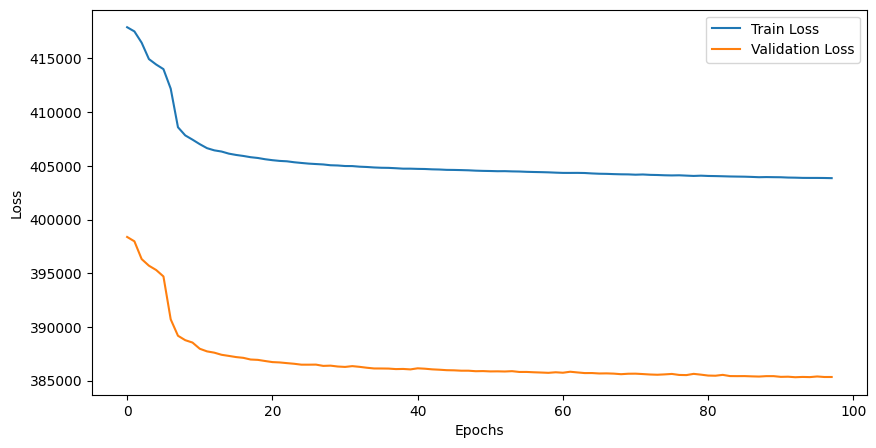

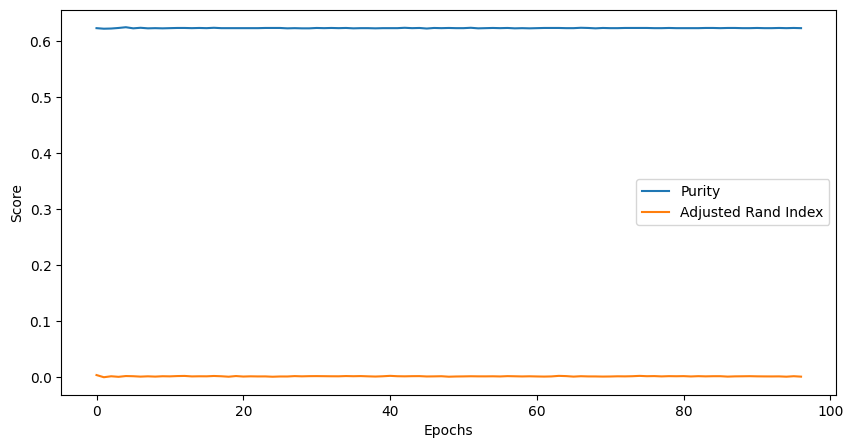

Test Loss: 12793.7099


In [3]:
from models import variational
from models import train_cluster, evaluate

encoder = variational.Encoder(num_layers, poolsize, channels,
                          kernel_sizes, dilations, activations)
decoder = variational.Decoder(encoder)
model = variational.AutoEncoder(encoder, decoder)

train_cluster(model, train_data, val_data,
      lr=learning_rate,
      batch_size=batch_size,
      epochs=epochs)
# model.load_state_dict(torch.load('./saved_models/variational_model.pt'))
evaluate(model, test_data,
         batch_size=batch_size)

torch.save(model, './models/variational_model.pt')

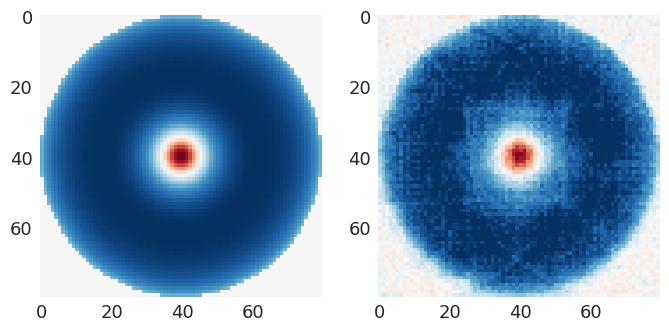

In [4]:
from plot import random_recon
random_recon(model, test_data)

In [5]:
from sklearn.cluster import HDBSCAN
from cluster_acc import purity, adj_rand_index

feature_array = model.feature_array(sim_arr_tensor)

clustering = HDBSCAN(min_cluster_size=5, cluster_selection_epsilon=0.1).fit(feature_array)
labels = clustering.labels_

print(f'Purity: {purity(labels)}')
print(f'ARI: {adj_rand_index(labels)}')

Purity: 0.6169435215946844
ARI: -0.005887455241537436


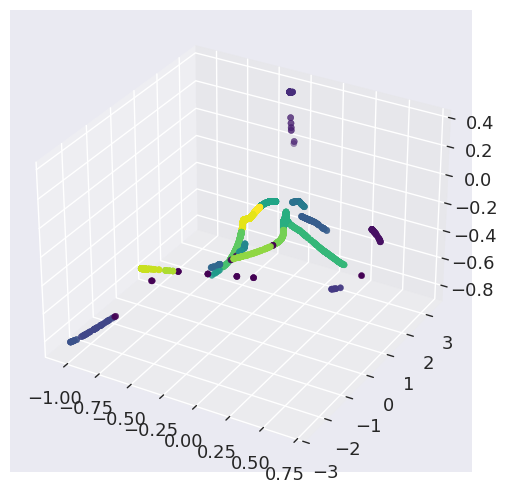

In [6]:
# plot the feature array in 3D with the labels as colors
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
# feature_array = feature_array[0].detach().to('cpu').numpy()
ax.scatter(feature_array[:, 0], feature_array[:, 1],
           feature_array[:, 2], c=labels)

In [7]:
from cluster_acc import adj_rand_index, purity

print("Adjusted Rand Index: ", adj_rand_index(labels))
print("Purity: ", purity(labels))

Adjusted Rand Index:  -0.005887455241537436
Purity:  0.6169435215946844


In [4]:
from plot import class_config
class_config(labels)

/tmp/ipykernel_1556636/2649573831.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./saved_models/variational_model.pt'))


FileNotFoundError: [Errno 2] No such file or directory: './saved_models/variational_model.pt'

/home/tummalas/hyper-param-optim-4-vector-field-clustering/plot/plotting.py:214: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



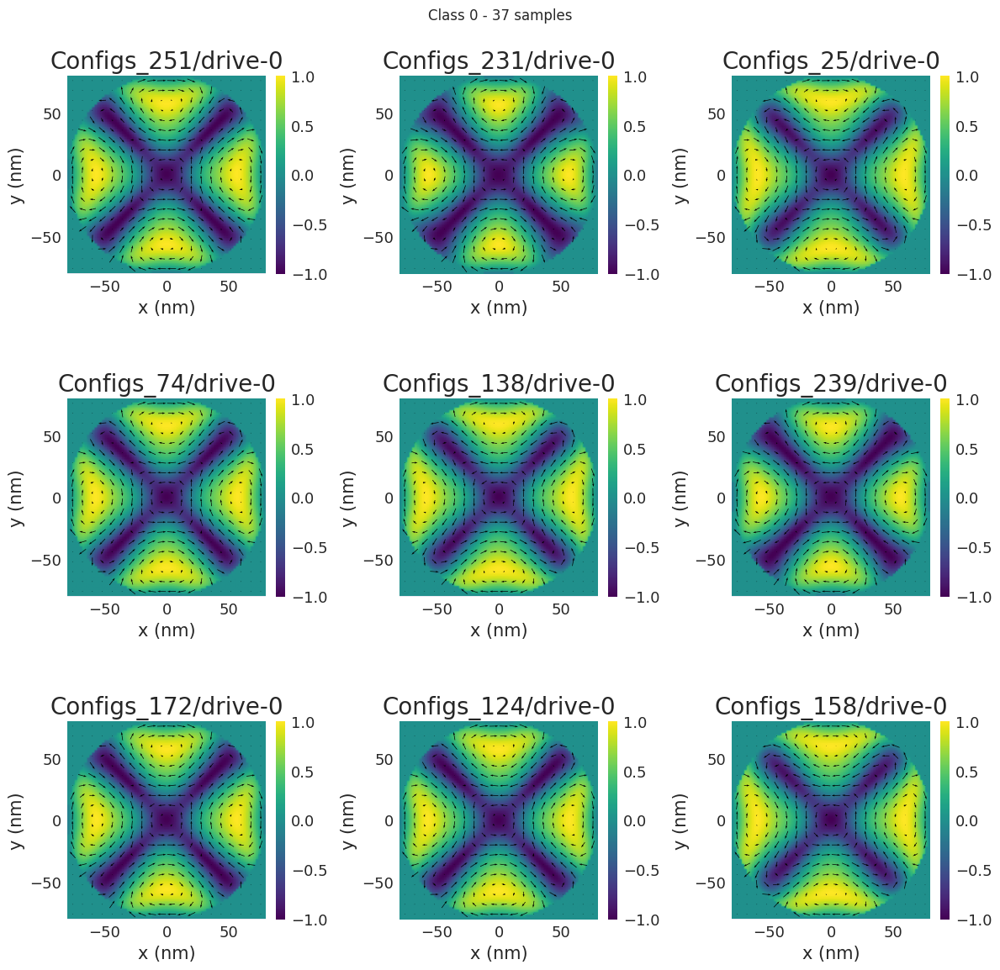

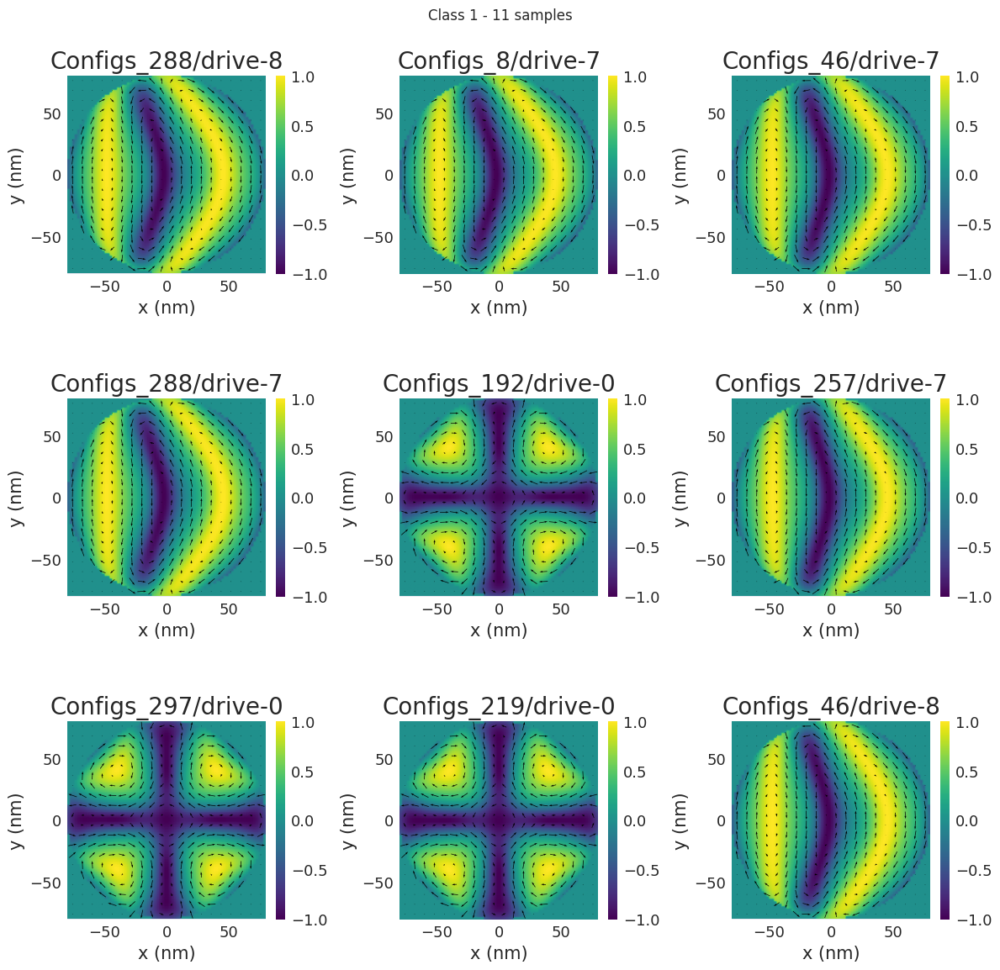

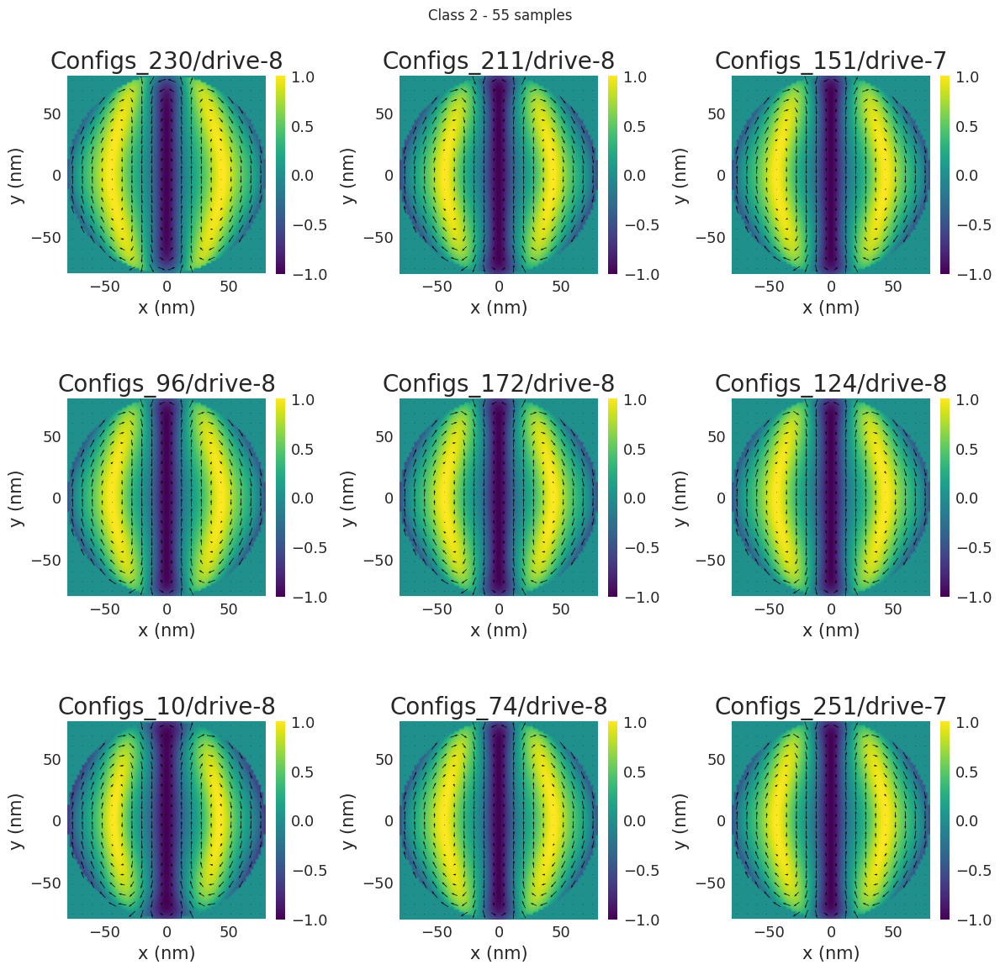

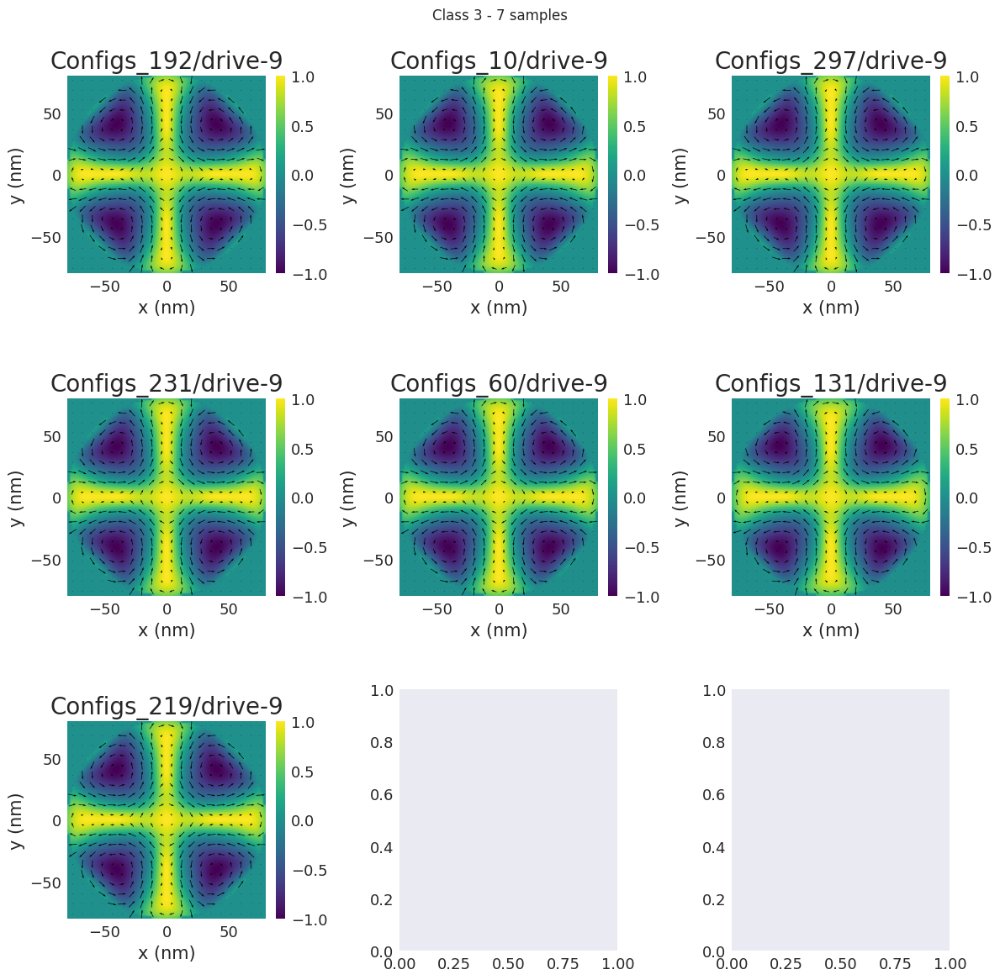

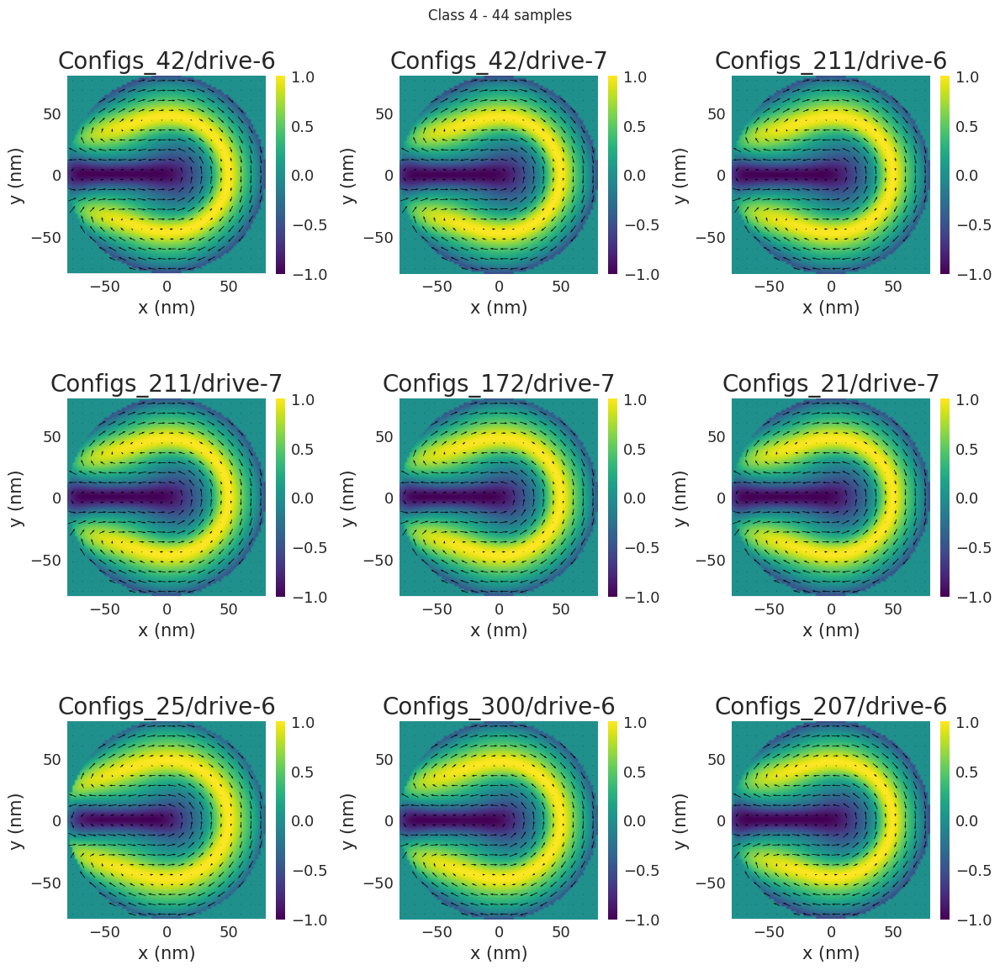

...

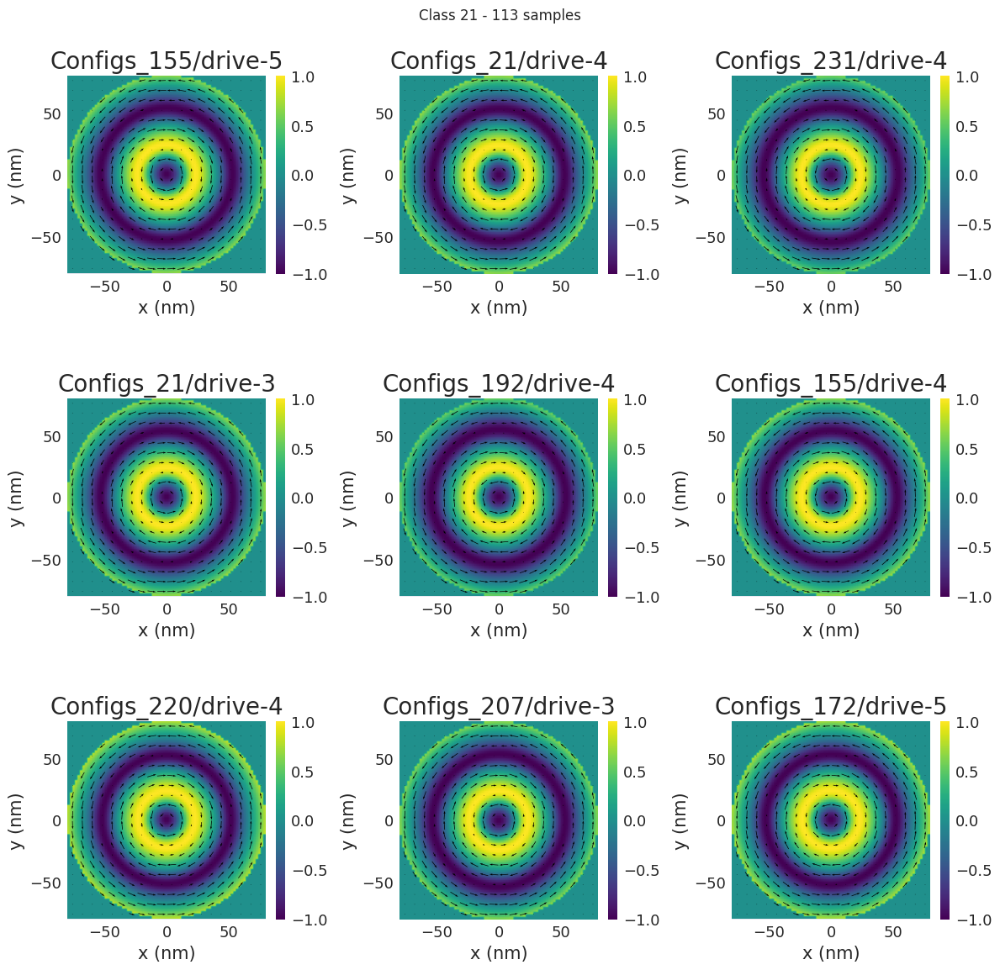

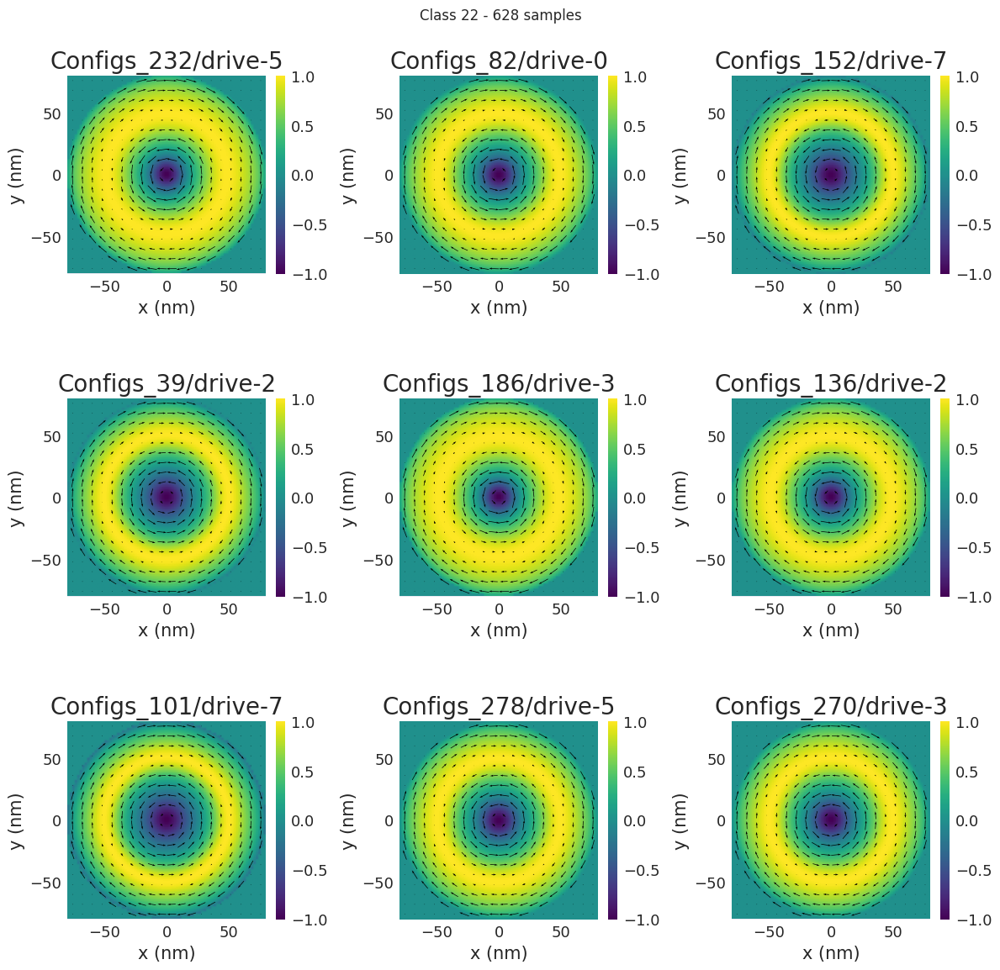

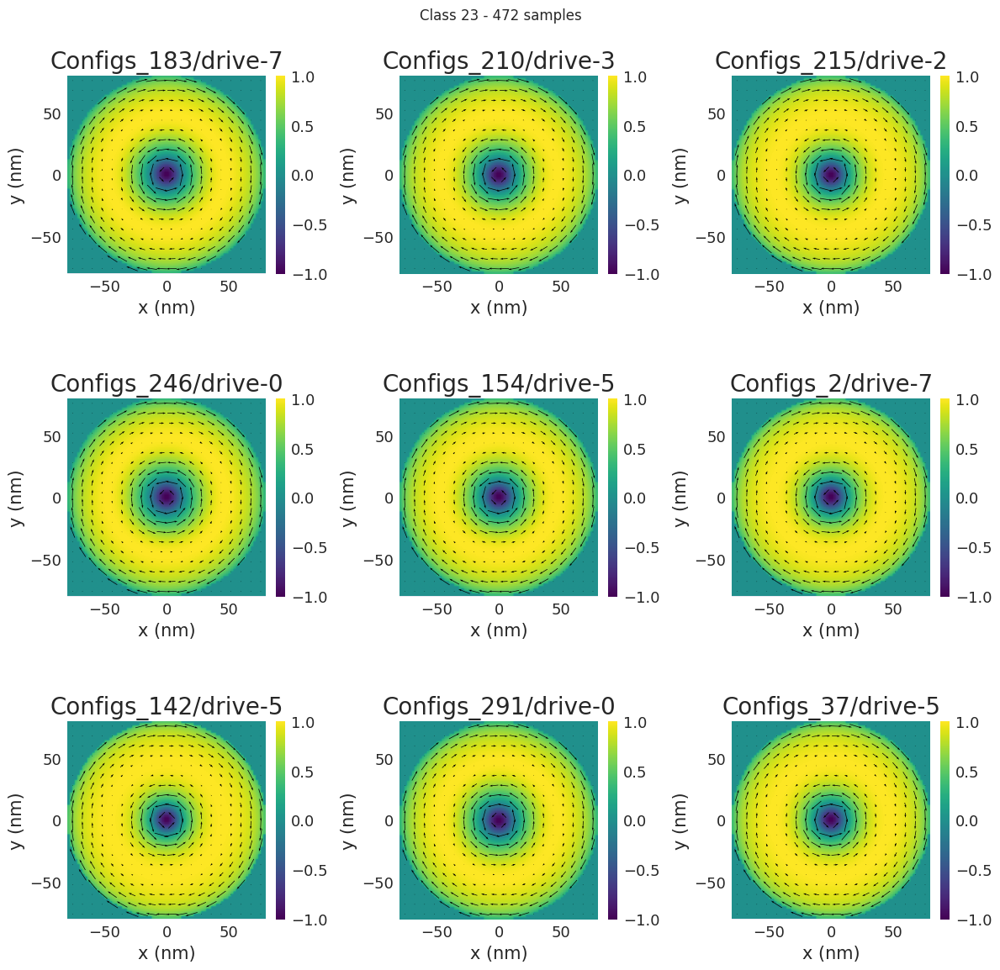

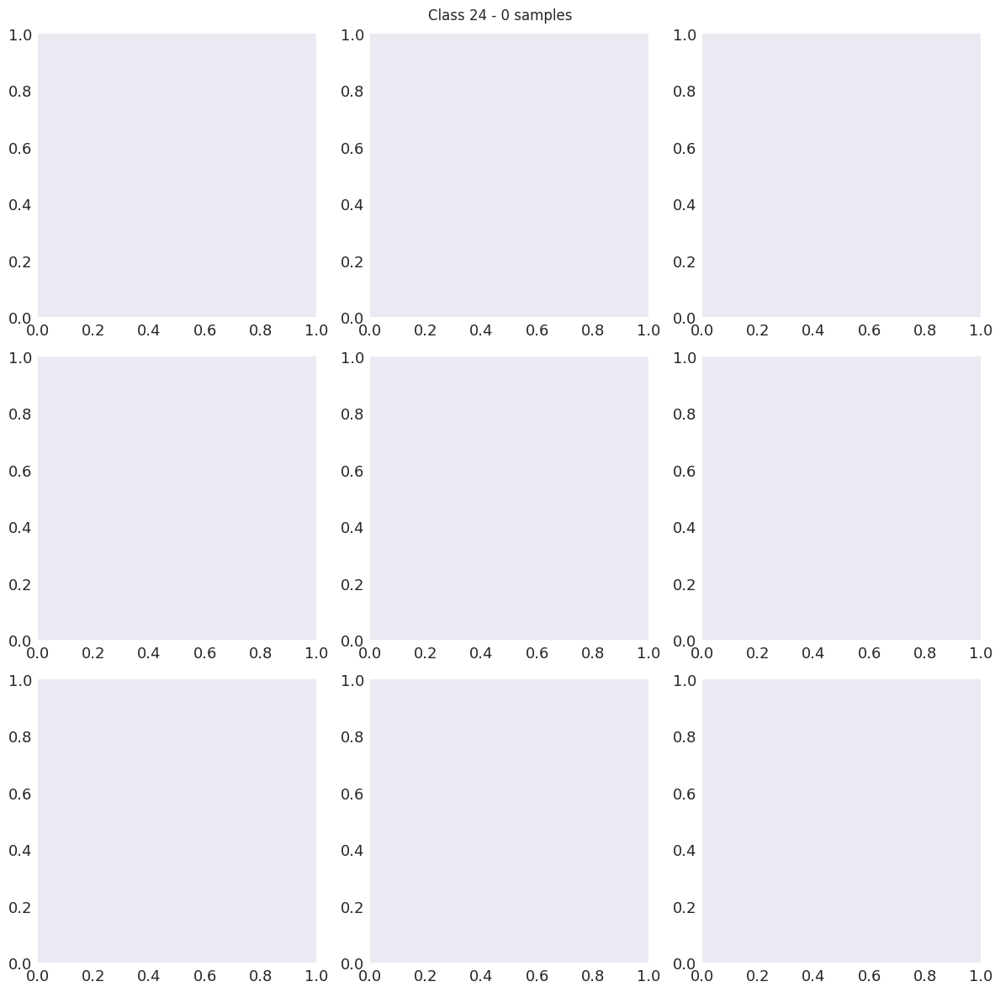

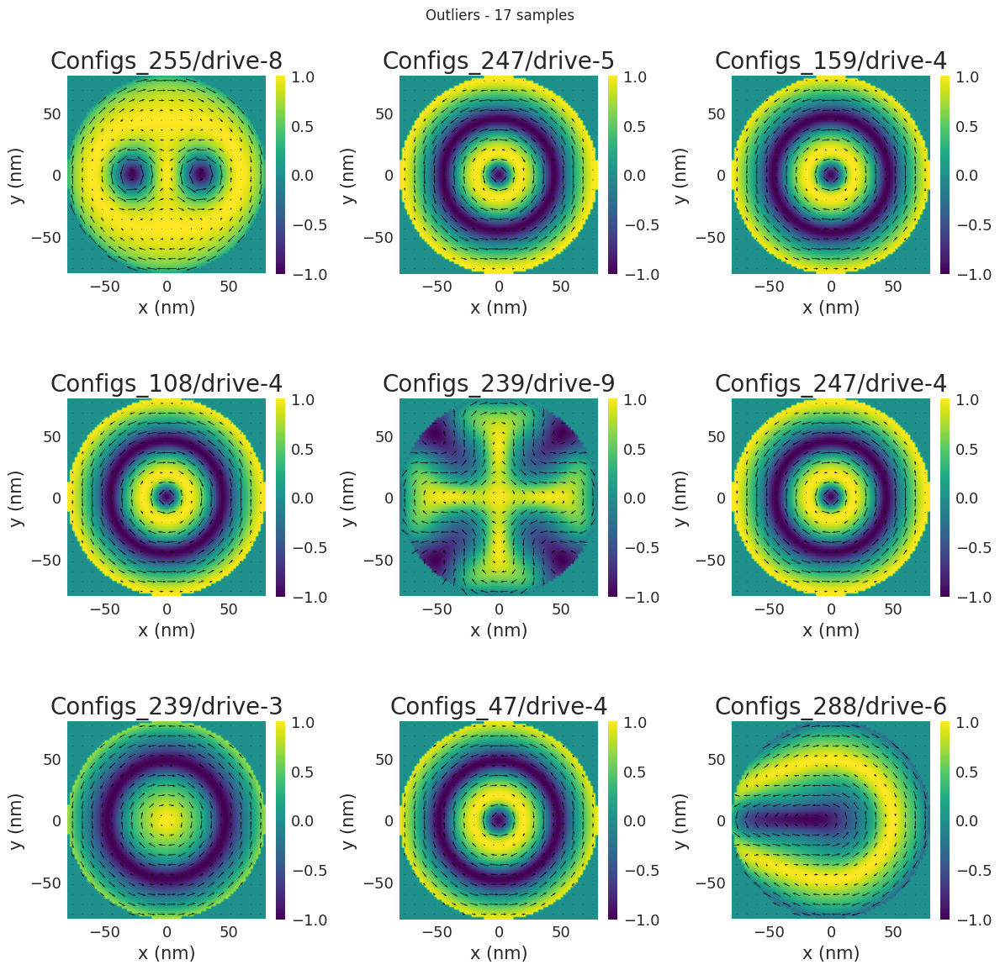

In [9]:
from plot import plot_all_examples

plot_all_examples(labels)